<h1 align = center> <font color = "#98AA44">Convolutional Neural Networks (CNN)</h1>

#### What is Convolutional Neural Networks (CNN) ?

Convolutional neural networks (CNNs) are a type of neural network architecture used for image recognition and computer vision tasks. They consist of two main components: convolutional layers and pooling layers. Convolutional layers extract features from the input image using filters, while pooling layers reduce the dimensionality of the feature maps. CNNs have been successful in achieving high accuracy in image classification, object detection, and segmentation tasks.

CNNs have several advantages over traditional neural networks for image recognition:

1. Efficient feature extraction: CNNs use convolutional layers to extract features from the input image, which are then processed by pooling layers to reduce the dimensionality of the feature maps. This reduces the computational complexity and allows the network to learn more complex patterns and representations.

2. Local receptive fields: Convolutional layers in CNNs have local receptive fields, allowing them to learn patterns at different locations in the input image. This allows the network to capture spatial information and improve the accuracy of image recognition tasks.

3. Parameter sharing: CNNs share the same weights and biases across different layers, reducing the number of parameters and making the model more efficient. This reduces the computational complexity and allows the network to learn more complex features.

4. Invariance to translation: CNNs are invariant to translation, meaning they can accurately recognize objects in different positions and orientations in the input image. This allows the network to generalize well to unseen data and improve the performance of image recognition tasks.

#### Convolutional Layer

A convolutional layer consists of several convolutional filters, each applied to a different region of the input image. The output of each convolutional filter is a feature map, which is a 2D matrix representing the responses of the filter to different regions of the input image. The number of feature maps in the convolutional layer is determined by the number of filters.

The convolution operation is performed by sliding the filter over the input image, multiplying the corresponding values in the filter and the input image, and summing the results. The output feature map at each position is the result of the convolution operation.

#### Pooling Layer

A pooling layer reduces the dimensionality of the feature maps by summarizing the information in different regions. There are two types of pooling layers: max pooling and average pooling. Max pooling selects the maximum value in each pooling region, while average pooling computes the average value.

Max pooling reduces the spatial size of the feature maps by dividing the input image into smaller non-overlapping regions, and then selecting the maximum value in each region. The output feature map at each position is the maximum value from the corresponding pooling region.

Average pooling computes the average value in each pooling region, and the output feature map at each position is the average value from the corresponding pooling region.

#### Kernels or Filters in CNN :

A convolutional layer in a CNN uses filters to extract features from the input image. The filters are typically small, square matrices, and are applied to different regions of the input image. The number of filters in a convolutional layer is determined by the desired level of abstraction, and the size and shape of the filters are chosen based on the complexity of the task and the available computational resources.

Each filter is applied to the input image using a convolution operation, where the filter is slid over the input image, multiplying the corresponding values in the filter and the input image, and summing the results. The output feature map at each position is the result of the convolution operation.




#### Activation Function in CNN

A convolutional layer in a CNN uses a non-linear activation function to introduce non-linearity and make the model more expressive. Common non-linear activation functions in CNNs include ReLU (Rectified Linear Unit), sigmoid, tanh, and Leaky ReLU. The choice of activation function depends on the specific task and the available computational resources.

ReLU activation functions introduce a non-negative activation, which helps to prevent the vanishing gradient problem in deep neural networks. Sigmoid activation functions are commonly used in binary classification tasks, while tanh activation functions are commonly used in tanh-based neural networks. Leaky ReLU activation functions introduce a small negative slope to the negative input values, which helps to mitigate the vanishing gradient problem.


#### Convolutional Neural Network Architecture

A typical convolutional neural network architecture for image recognition consists of multiple convolutional layers followed by a series of pooling layers and fully connected layers. The number of convolutional filters in each convolutional layer is determined by the desired level of abstraction, and the size and number of pooling regions are chosen based on the complexity of the task and the available computational resources.


#### Difference Between ANN and CNN 

ANNs and CNNs have different architectures and learning algorithms, but they share some common concepts and principles. ANNs are simple, feed-forward neural networks that process input data by applying a series of linear transformations and non-linear activation functions. CNNs, on the other hand, are more complex, convolutional neural networks that use convolutional layers to extract features from the input image and pooling layers to reduce the dimensionality of the feature maps.

ANNs are well-suited for tasks such as pattern recognition, classification, and regression, while CNNs are better suited for tasks such as image recognition, object detection, and segmentation. ANNs are easier to implement and train, but CNNs have better performance and generalization capabilities.

#### Can we use CNN for regression problems without image input ?

Yes, CNNs can be used for regression problems without image input as long as the input data is structured and can be represented as a 2D matrix. The input data can be features extracted from the raw data, such as pixel values, color histograms, or text representations.




###  Importing Necessary Libraries

In [717]:
import tensorflow as tf
import numpy as np
import cv2
import matplotlib.pyplot as plt

import PIL.Image
import pilgram

import os

<h2 align = center><font color = "#AA2311"> Applying Different Filters Using Convolutional Neural Networks

Since Guassian Blur Work Better on Grayscale Photos so i am importing a greyscaled photo of bird

### Importing Image

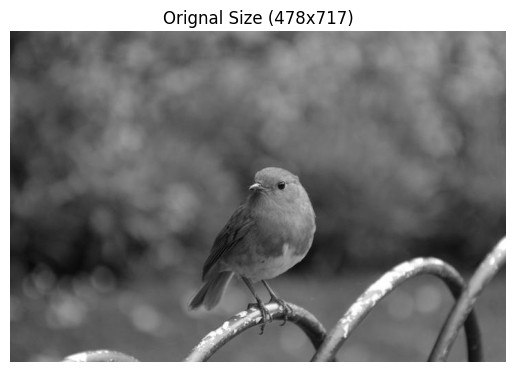

In [651]:
image_path = 'bird.jpg'
input_image = cv2.imread(image_path)
input_image_rgb = cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB)
# input_image = cv2.cvtColor(input_image, cv2.COLOR_BGR2GRAY)
plt.imshow(input_image_rgb)
plt.title(f'Orignal Size ({input_image.shape[0]}x{input_image.shape[1]})')
plt.axis('off')  # Hide axis labels
plt.show()


## Resizing Image For Input

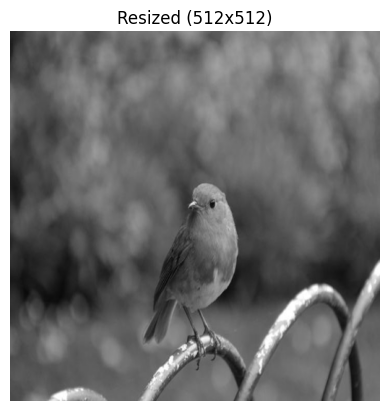

In [652]:
input_image = cv2.resize(input_image,(512,512))
resize_image_rgb = cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB)

plt.imshow(resize_image_rgb)
plt.title(f'Resized ({input_image.shape[0]}x{input_image.shape[1]})')

plt.axis('off')  # Hide axis labels
plt.show()







### Normalizing Image


In [653]:
input_image = input_image.astype(np.float32)/255.0


### Adding Batch Dimension Because Conv2D required 4D tensor with the shape (batch_size, height, width, channels)

In [654]:

input_image = np.expand_dims(input_image, axis=0)  # Add batch dimension


## Filters

### Horizontal Egde Detection Filter



In [655]:
# Define Gaussian filter
hor_edge_filter = np.array([[30, 30, 30,],
                            [0, 0, 0,],
                            [-30, -30, -30,]], dtype=np.float32)


hor_edge_filter = hor_edge_filter / 159.0
hor_edge_filter = hor_edge_filter[:, :, np.newaxis, np.newaxis] 
hor_edge_filter = np.repeat(hor_edge_filter, 3, axis=2)  
hor_edge_filter = np.repeat(hor_edge_filter, 3, axis=3) 

### Vertical Egde Detection Filter

In [656]:
ver_edge_filter= np.array([[30, 0, -30,],
                            [30, 0, -30,],
                            [30, 0, -30,]], dtype=np.float32)

ver_edge_filter = ver_edge_filter / 159.0
ver_edge_filter = ver_edge_filter[:, :, np.newaxis, np.newaxis]  # Shape: (3, 3, 1, 1)
ver_edge_filter = np.repeat(ver_edge_filter, 3, axis=2)  # For input channels
ver_edge_filter = np.repeat(ver_edge_filter, 3, axis=3) 


### Sharpness Filter

In [657]:

sharpness_filter = np.array([[ 0, -1,  0],
[-1,  5, -1],
[ 0, -1,  0],],dtype=np.float32)

sharpness_filter = sharpness_filter[:, :, np.newaxis, np.newaxis]  # Shape: (3, 3, 1, 1)
sharpness_filter = np.repeat(sharpness_filter, 3, axis=2)  # For input channels
sharpness_filter = np.repeat(sharpness_filter, 3, axis=3) 

### Embossing Filter

In [658]:

embos_filter = np.array([[-2, -1, 0],
[-1,  1, 1],
[ 0,  1, 2],
])

embos_filter = embos_filter[:, :, np.newaxis, np.newaxis]  # Shape: (3, 3, 1, 1)
embos_filter = np.repeat(embos_filter, 3, axis=2)  # For input channels
embos_filter = np.repeat(embos_filter, 3, axis=3) 


### Defining Convolutional Layers

In [659]:
input_image = input_image.reshape((1, 512, 512, 3))  # Reshape to (batch_size, height, width, channels)
con_layer = tf.keras.layers.Conv2D(filters=3,kernel_size=(3,3),strides=(1,1),padding='same',kernel_initializer=tf.constant_initializer(hor_edge_filter))
con_layer2 = tf.keras.layers.Conv2D(filters=3,kernel_size=(3,3),strides=(1,1),padding='same',kernel_initializer=tf.constant_initializer(ver_edge_filter))
con_layer3 = tf.keras.layers.Conv2D(filters=3,kernel_size=(3,3),strides=(1,1),padding='same',kernel_initializer=tf.constant_initializer(sharpness_filter))
con_layer4 = tf.keras.layers.Conv2D(filters=3,kernel_size=(3,3),strides=(1,1),padding='same',kernel_initializer=tf.constant_initializer(embos_filter))




### Applying Convolutional Layer on Image


In [660]:
output1 = con_layer(input_image)
output2 = con_layer2(input_image)
output3 = con_layer3(input_image)
output4 = con_layer4(input_image)


print("Shape",output1.shape)
print("Shape",output2.shape)
print("Shape",output3.shape)
print("Shape",output4.shape)




Shape (1, 512, 512, 3)
Shape (1, 512, 512, 3)
Shape (1, 512, 512, 3)
Shape (1, 512, 512, 3)


### Removing batch Dimension

In [661]:
output_image1 = np.squeeze(output1.numpy())
output_image2 = np.squeeze(output2.numpy())
output_image3 = np.squeeze(output3.numpy())
output_image4 = np.squeeze(output4.numpy())




### Outputing The Guassian Blurred Image

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9944507..1.6381798].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.98113215..1.6936736].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.3176472..6.211765].


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-6.5647044..9.188235].


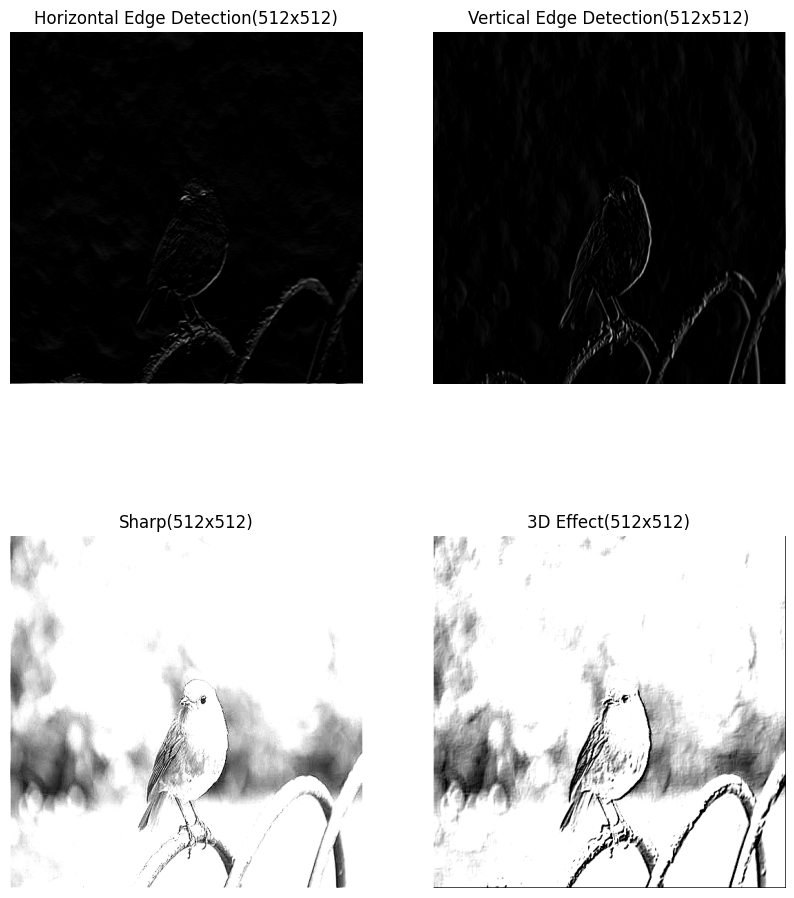

In [662]:
plt.figure(figsize=(10,12))
plt.subplot(2,2,1)



plt.imshow(output_image1)
plt.title(f'Horizontal Edge Detection({output_image1.shape[0]}x{output_image1.shape[1]})')
plt.axis('off')

plt.subplot(2,2,2)

plt.imshow(output_image2)
plt.title(f'Vertical Edge Detection({output_image2.shape[0]}x{output_image2.shape[1]})')
plt.axis('off')

plt.subplot(2,2,3)

plt.imshow(output_image3)
plt.title(f'Sharp({output_image3.shape[0]}x{output_image3.shape[1]})')
plt.axis('off')


plt.subplot(2,2,4)

plt.imshow(output_image4,cmap = 'grey')
plt.title(f'3D Effect({output_image4.shape[0]}x{output_image4.shape[1]})')
plt.axis('off')

plt.show()



<h2 align = center> <font color = '#AAF871'> Now we are applying Filters Using PILLOW and pilgram Library

### Making A Function For Applying Filters

In [747]:
import random
def apply_filter(folderPath , filter_name ):

    # Get all image paths in the folder
    image_paths = [os.path.join(folderPath, img) for img in os.listdir(folderPath) if img.endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff'))]

    # Randomly select 5 images
    selected_images = random.sample(image_paths, min(len(image_paths), 5))

    for image_path in selected_images:
        image = PIL.Image.open(f'{image_path}')
        image.thumbnail((512,512))
        output = filter_name(image)



        plt.figure(figsize=(10,6))
        filter = str(filter_name)
        
        plt.title(f"Filter Name: {(filter).split()[1]}")
        plt.axis('off')


        plt.subplot(1,2,1)
        plt.title("Orignal")
        plt.imshow(image)
        plt.axis('off')



        plt.subplot(1,2,2)
        plt.title('Filtered')
        plt.imshow(output)

        plt.axis('off')

        plt.show()



### Lofi Filter

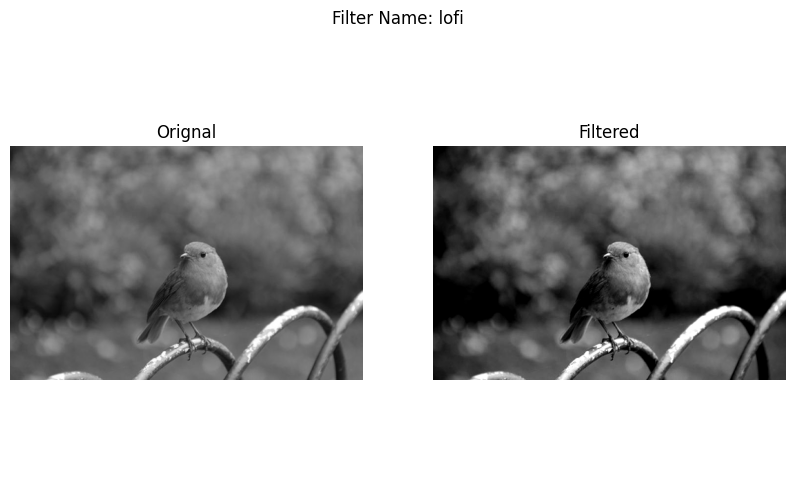

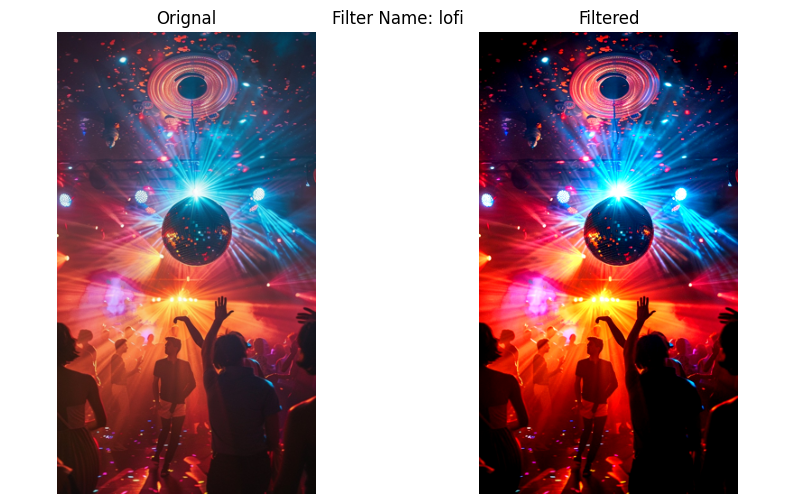

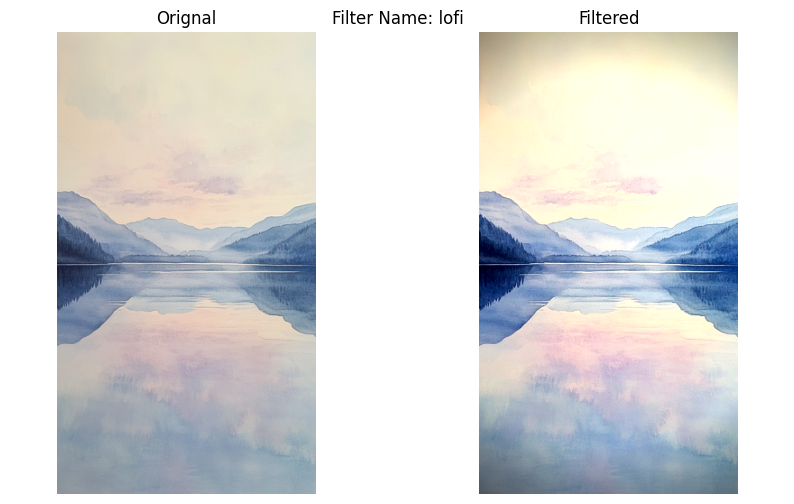

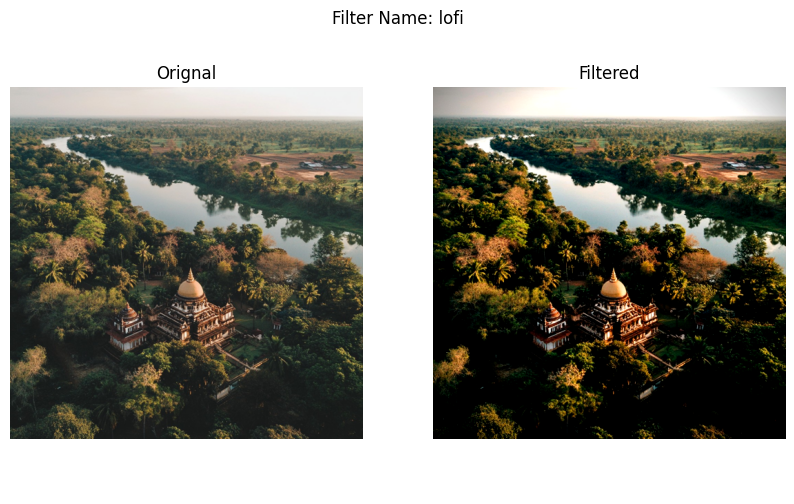

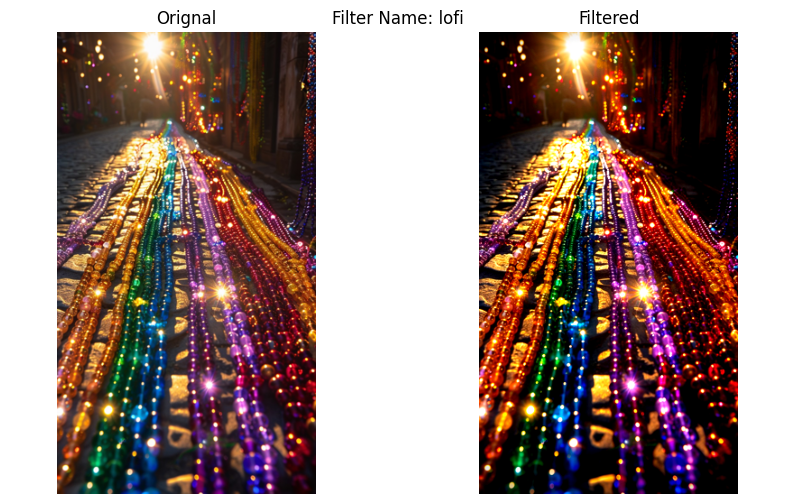

In [748]:
apply_filter('images' , pilgram.lofi)


### earlybird Filter

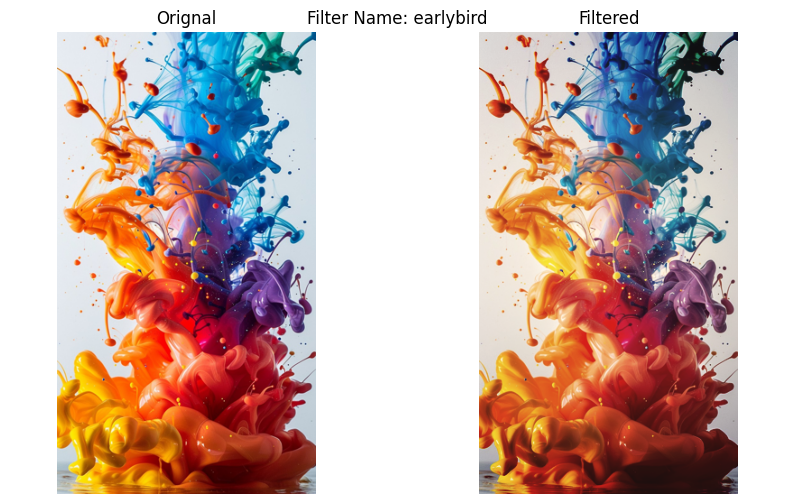

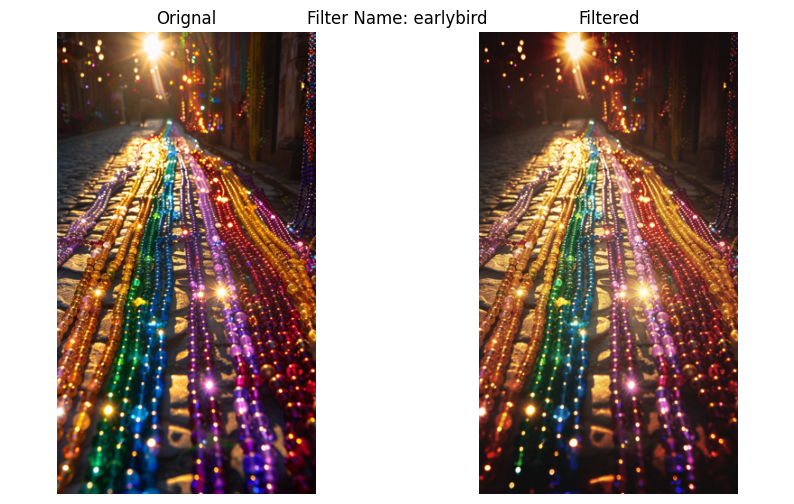

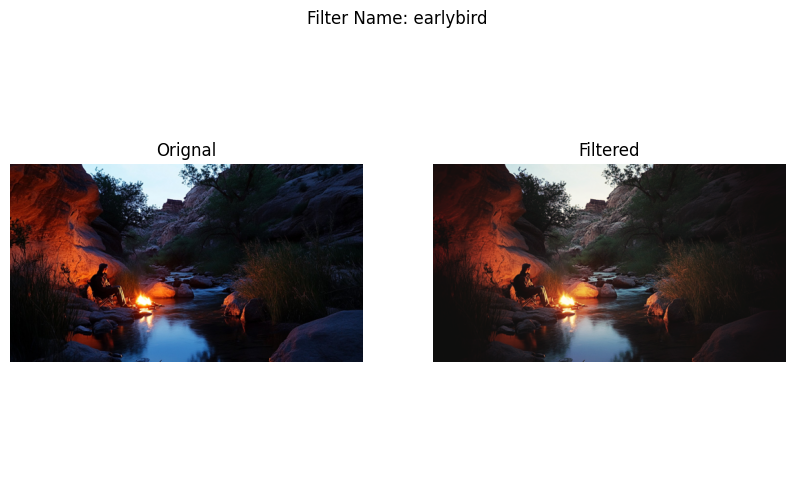

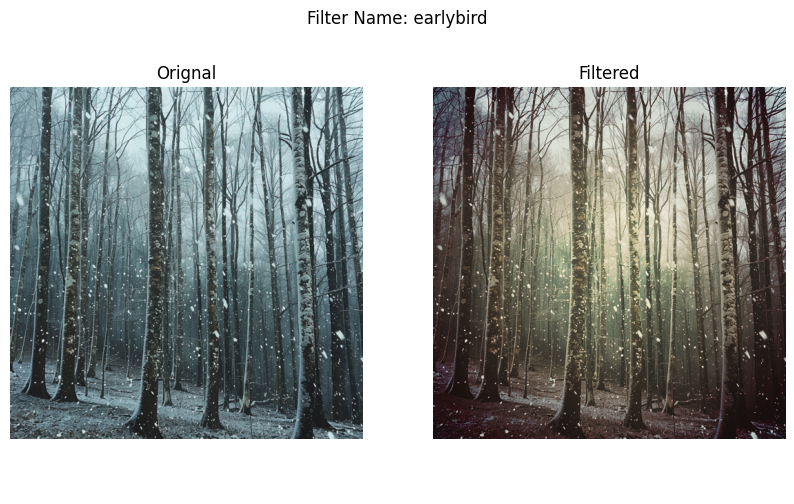

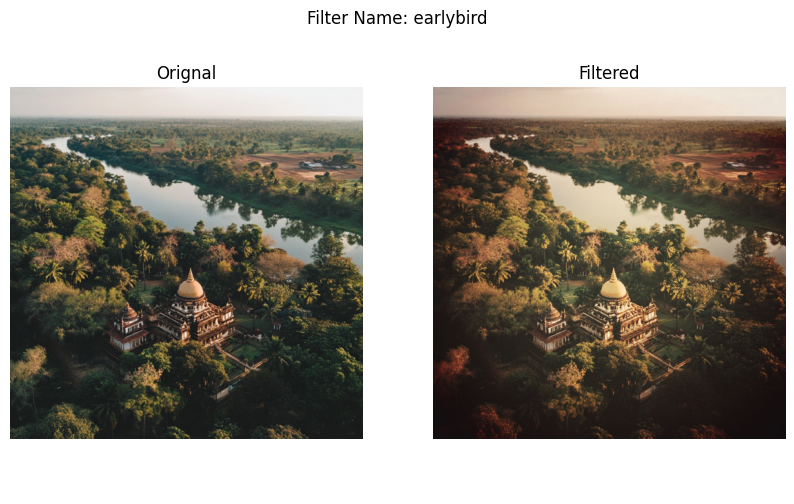

In [749]:
apply_filter('images',pilgram.earlybird)

### moon Filter

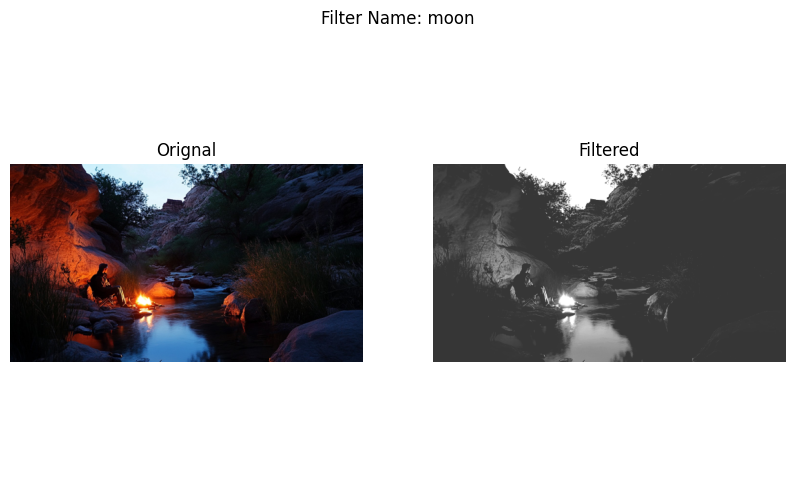

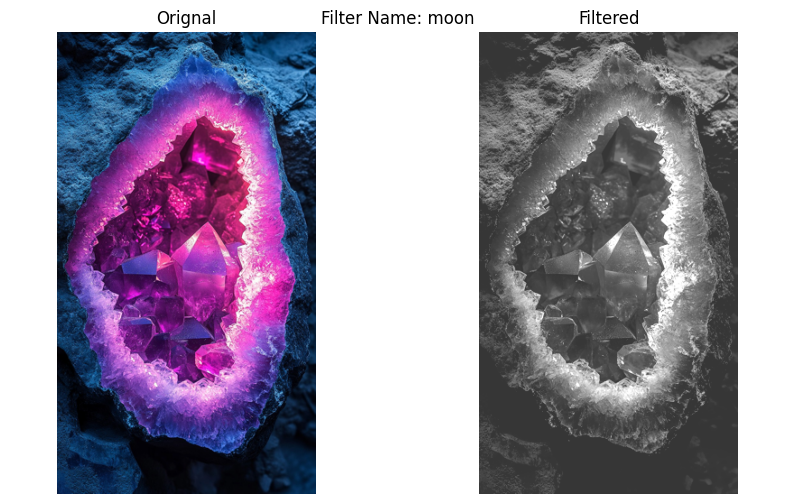

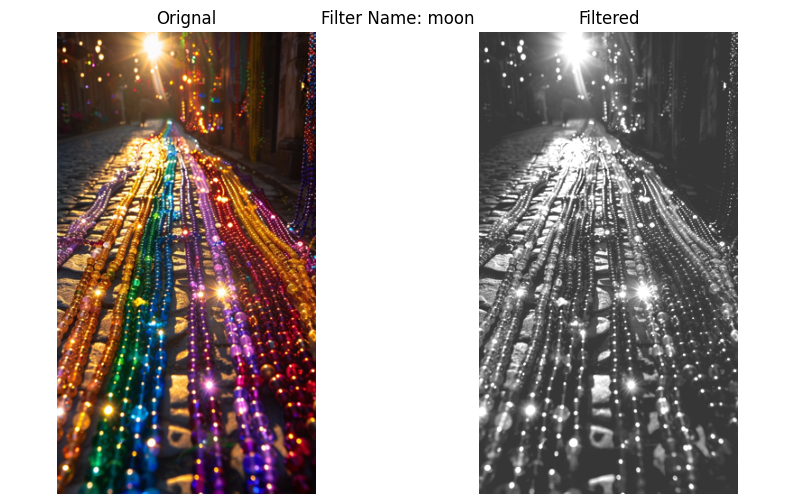

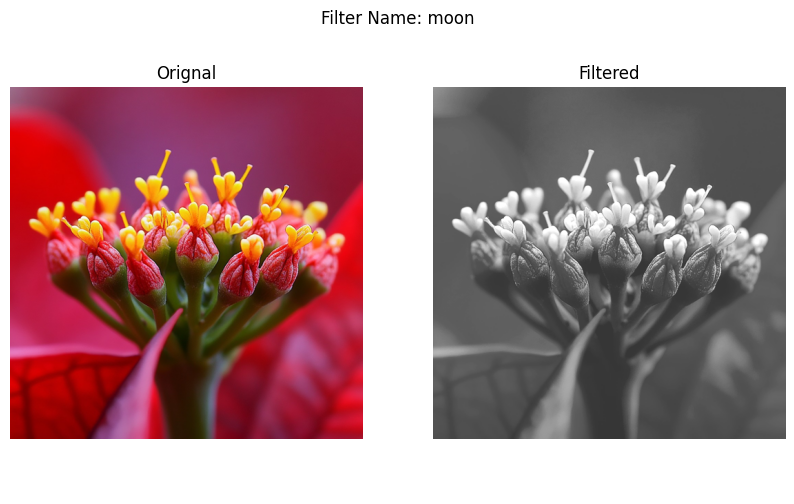

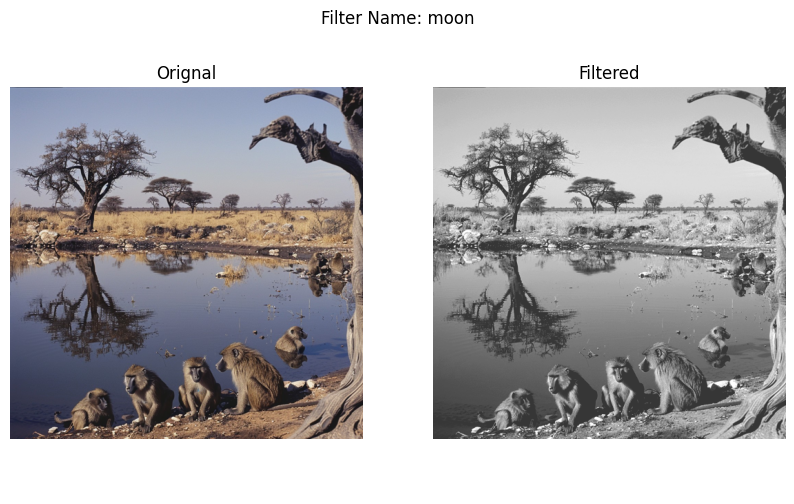

In [750]:
apply_filter('images',pilgram.moon)

### aden Filter

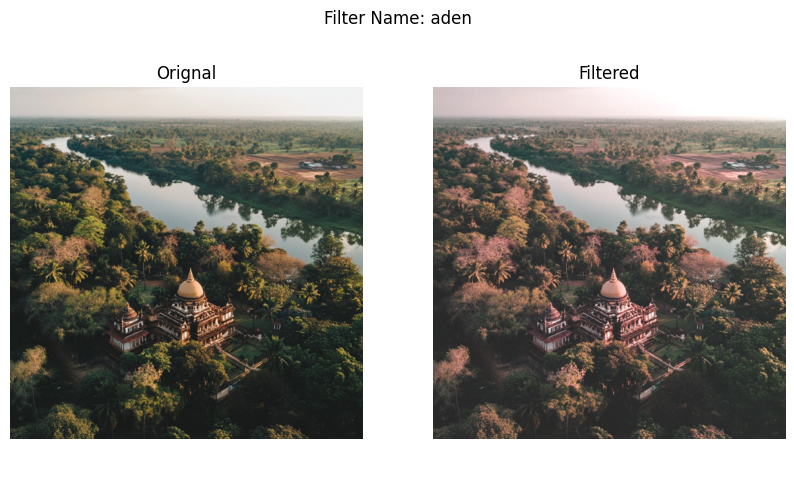

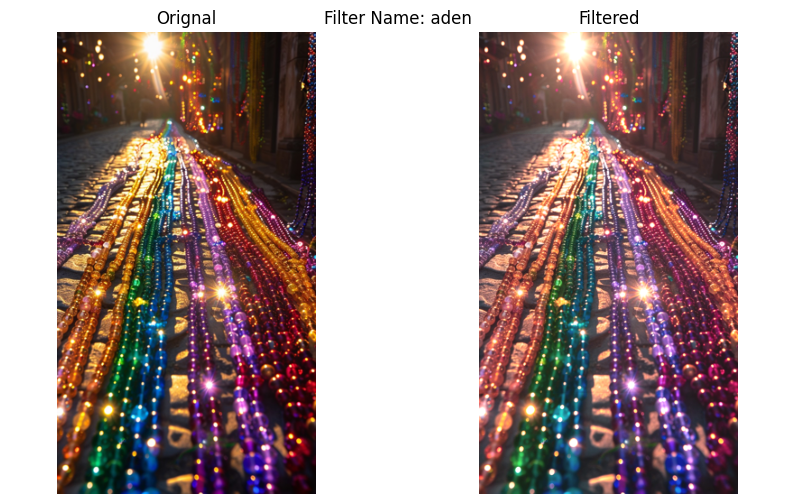

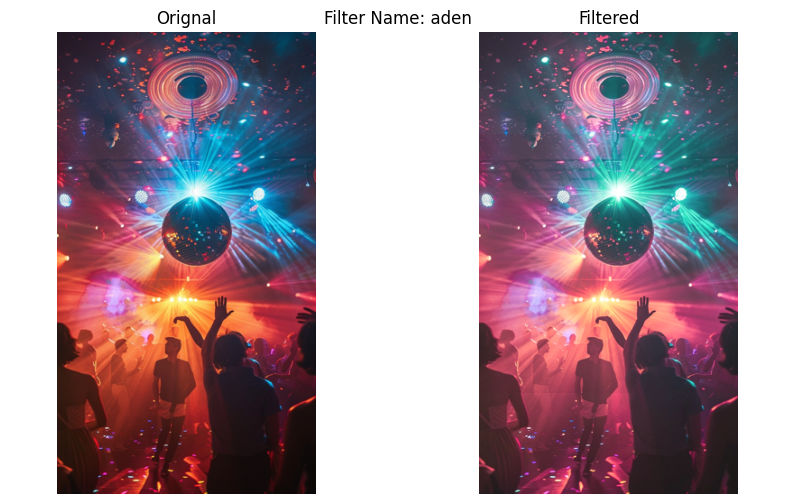

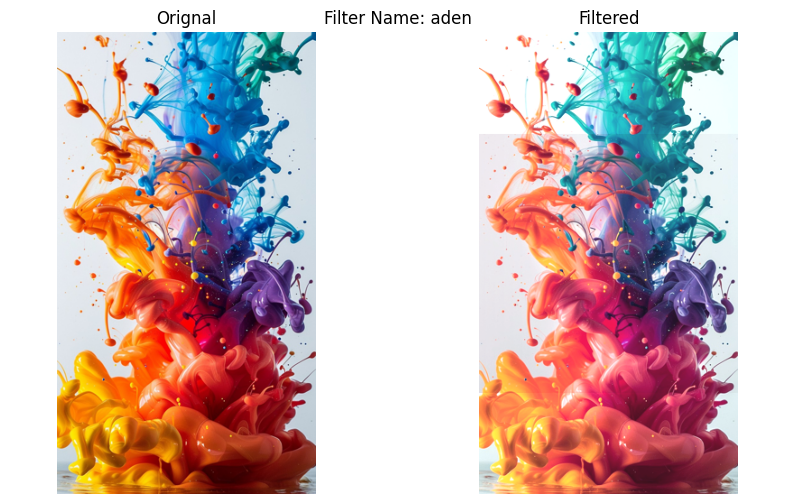

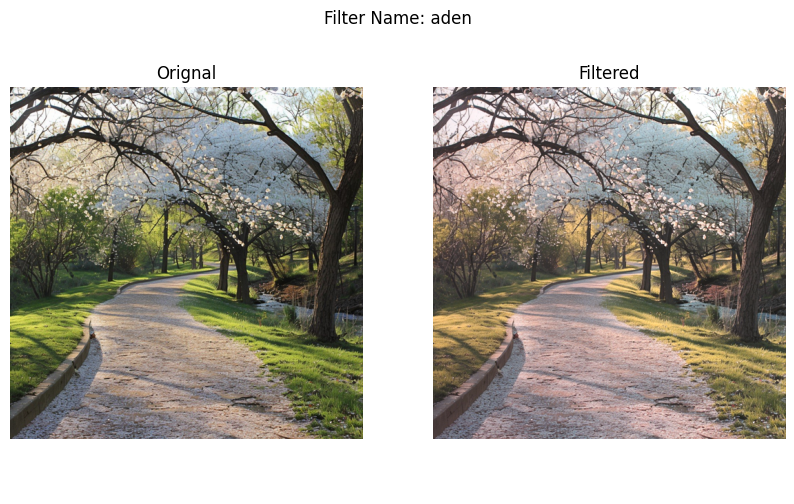

In [751]:
apply_filter('images',pilgram.aden)

### 1977 Filter

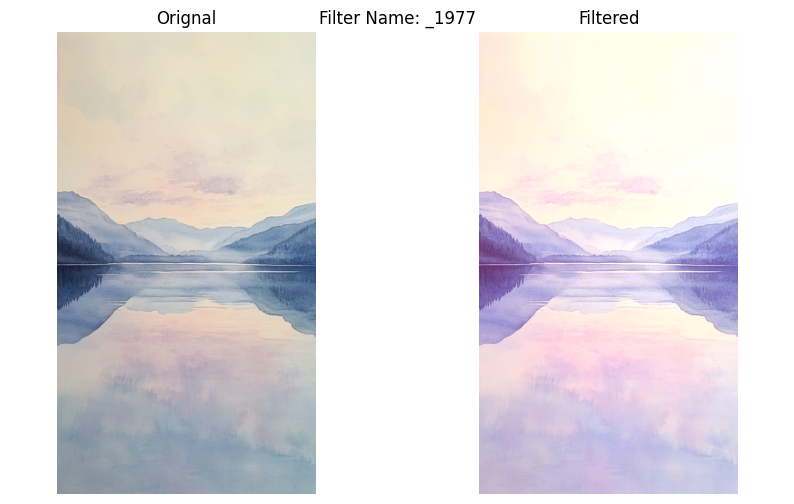

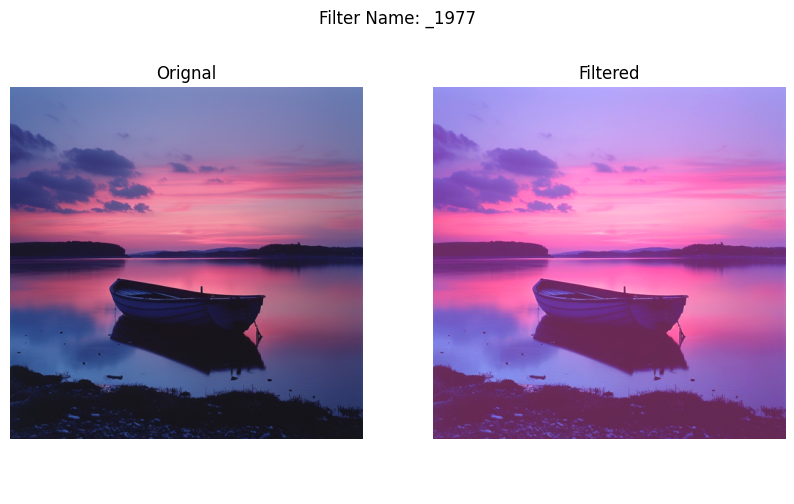

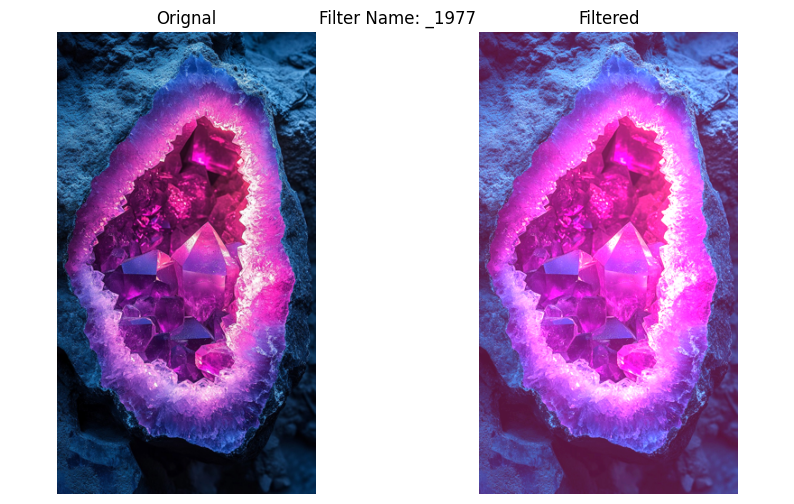

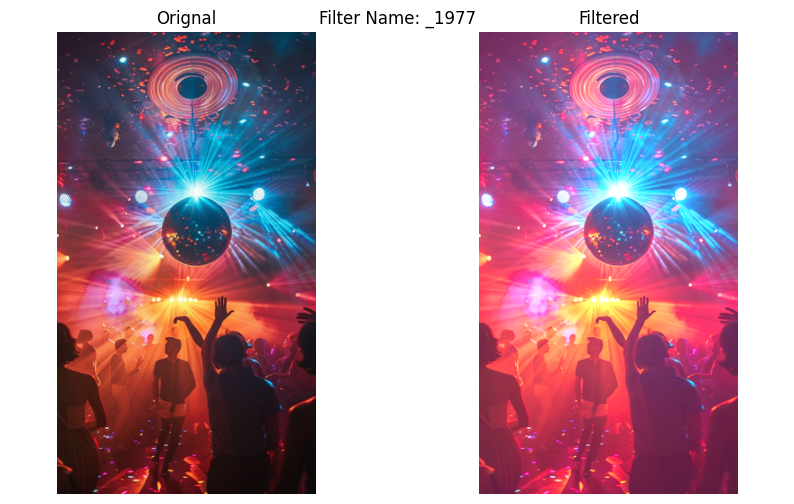

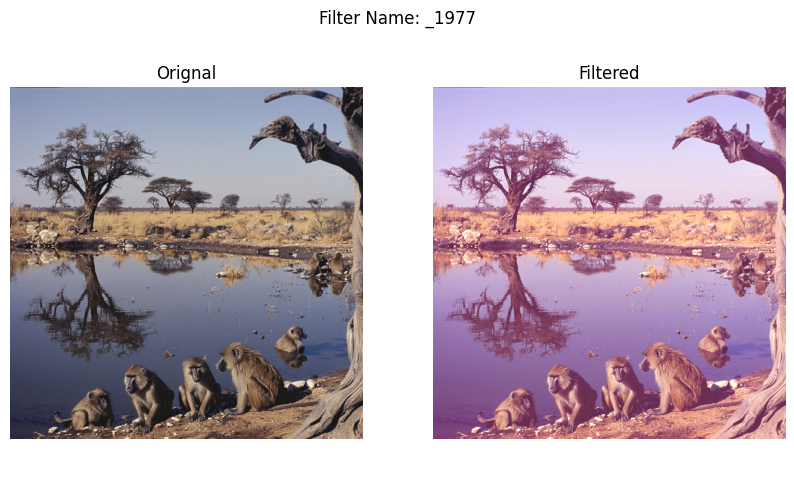

In [752]:
apply_filter('images',pilgram._1977)


### gingham Filter

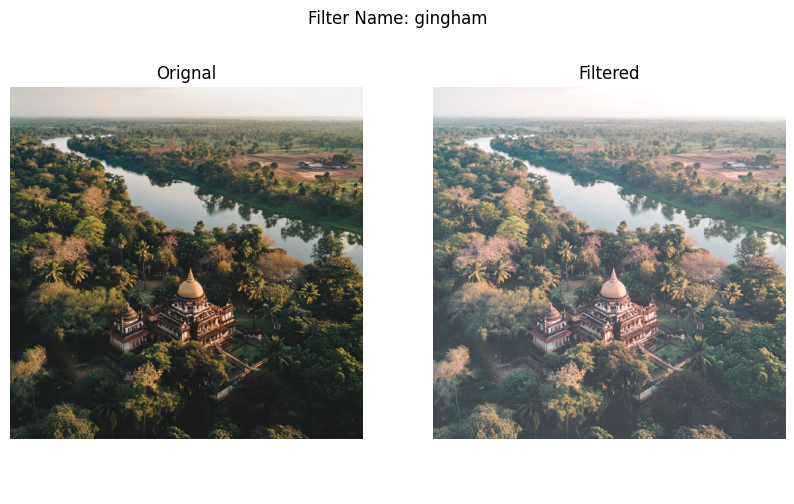

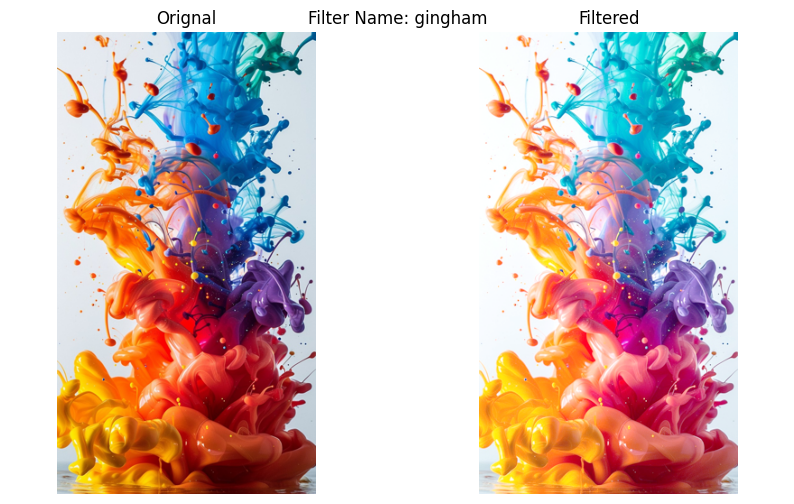

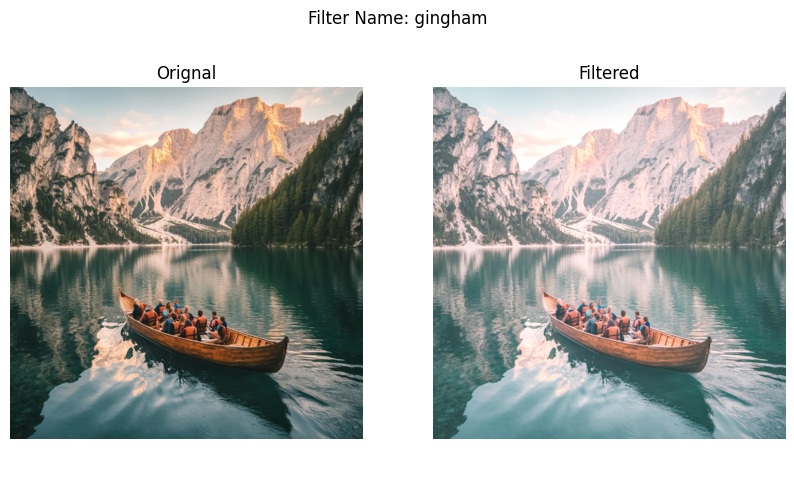

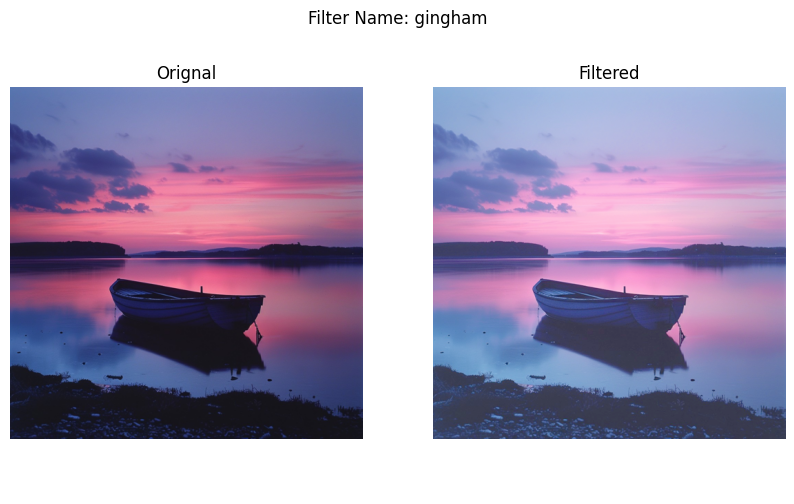

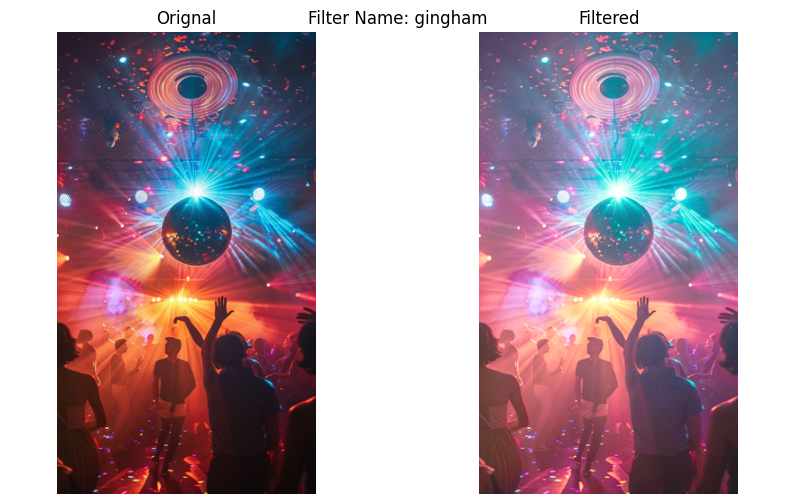

In [753]:
apply_filter('images',pilgram.gingham)

### nashville Filter

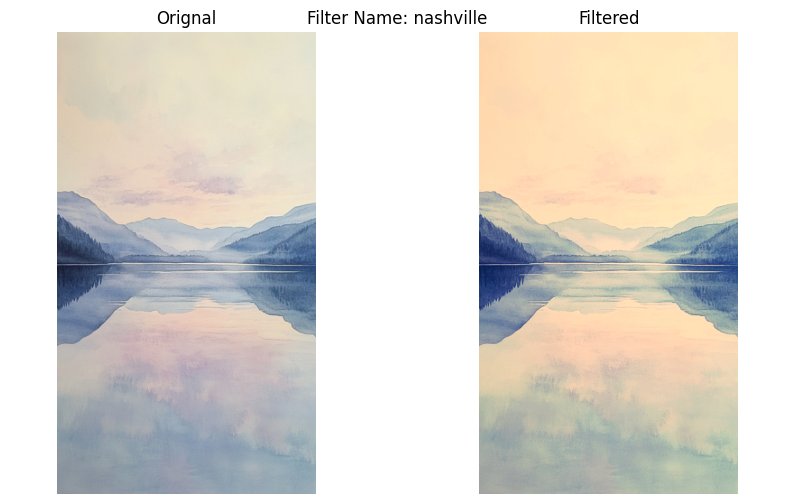

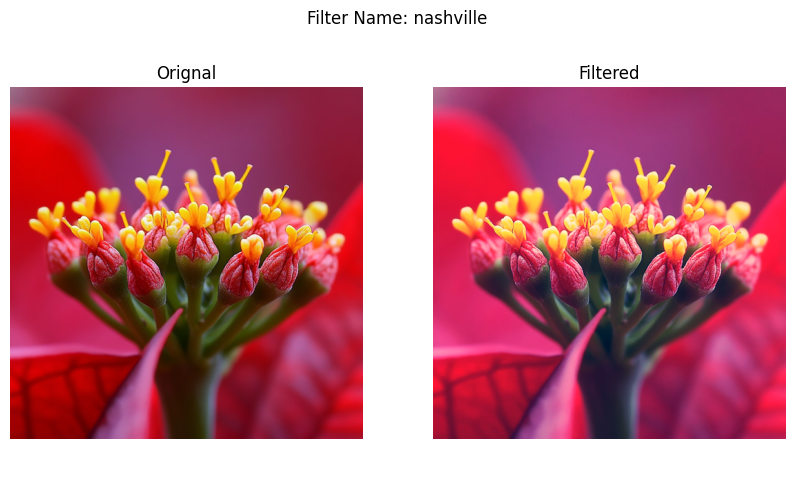

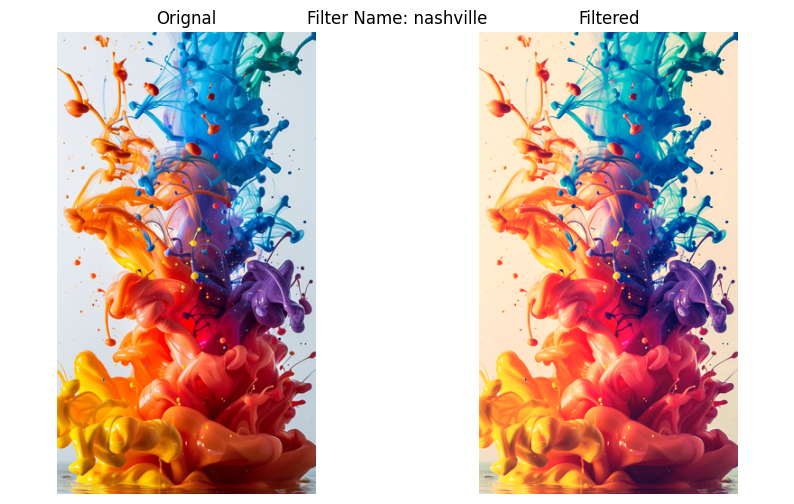

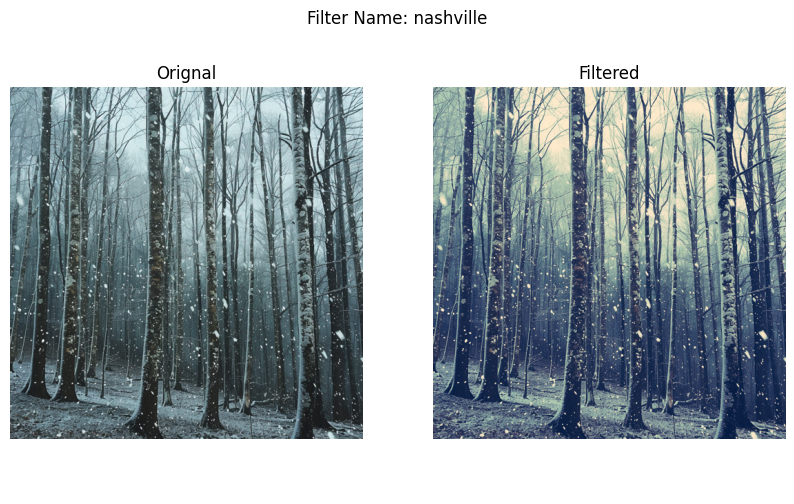

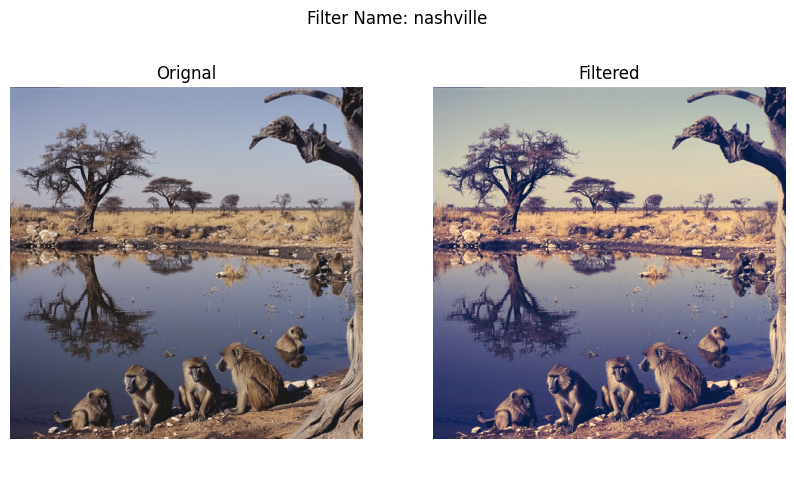

In [754]:
apply_filter('images',pilgram.nashville)

<h2 align = center> <font color = "#FF00FF">Conclusion</h2>





In this Python code, we demonstrated how to load an image using TensorFlow, resize it, normalize it, and apply filters using both TensorFlow and PILLOW. The filters applied are Gaussian Blur, Horizontal Edge Detection, Vertical Edge Detection, Sharpness, and Embossing. The results show the effects of these filters on the original image.

For TensorFlow, we used a custom convolutional layer to apply the filters. The filters were defined as TensorFlow constant initializers, and the convolutional layer was applied to the input image.

For PILLOW, we used the pilgram library to apply the filters. The filters were defined as functions in the pilgram module, and the apply_filter function was used to apply each filter to an image. The results show the filtered images of each filter applied to the original image.

In both TensorFlow and PILLOW, the results are visually appealing and show the effects of the filters on the original image. The TensorFlow implementation is more efficient and allows for more complex operations, while the PILLOW implementation is easier to use and provides more control over the filters. The choice between TensorFlow and PILLOW depends on the specific requirements and preferences of the user.